# Assignment 05

This is the second part of the assignment (last assignment!).

Submission by: see Canvas

In [1]:
# import packages
import numpy as np
import pandas as pd
import re
#import matplotlib.pyplot as mpl
import cv2
from PIL import Image
from PIL import ImageFilter
import matplotlib.pyplot as plt

## Assignment 05: Images (open ended)

#### Choose your image (or set of images)

1) choose an underexposed (low light) image online (search on google "low light" or "underexposed")

2) check if you can access the page and process it! if not, do not use it

3) get the image with urlib

************
#### Compress the image

1) first of all, just make the image smaller (at least 4 times smaller)


************
#### Fix the image

1) check the image RGB components: print_RGB_histogram

2) write down (in words) what you want to do to fix the image

3) get the image in numpy

4) fix the image

5) display the image

************
#### Optional: more on filter

1) change the color components (more green, more red, or less blue, your choice)

************
#### Optional: more on filter

1) apply one of the filter to make the image blurry (see the presentation for W9 L17)

<br>
<br>
<br>

# Introduction

In this image project, I used a photo I took last summer. I like the flowers in the photo, they have details and vibrant colors. However, the image is underexposed, so I would like to fix it and make it more artistic in this project.

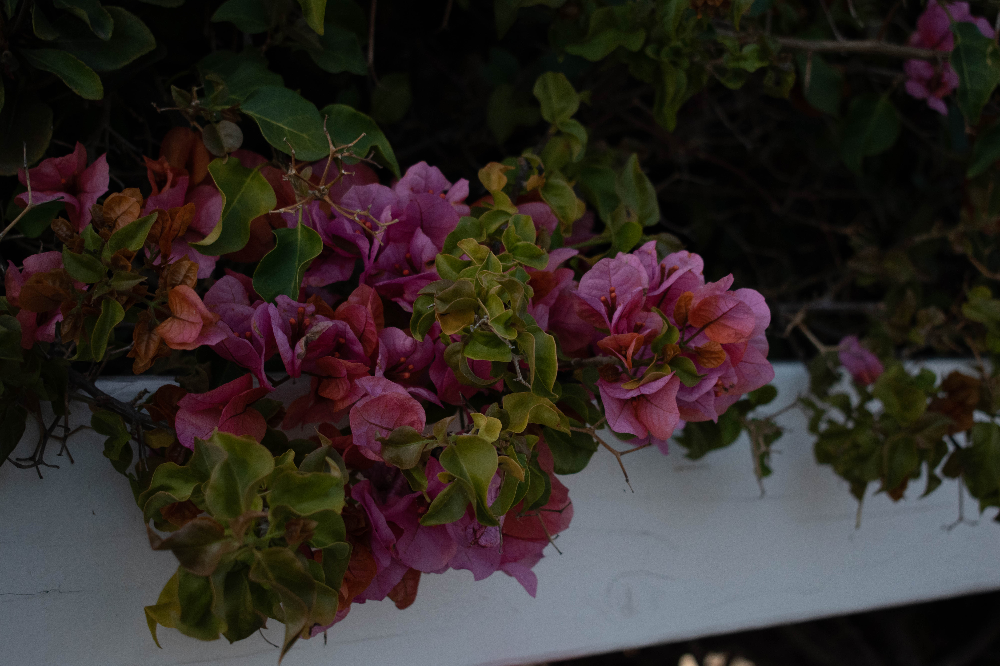

In [2]:
my_image = Image.open('data/flower.jpg')
display(my_image)

The size of the image is large

In [3]:
flower_arr = np.array(my_image)
flower_arr.shape

(4000, 6000, 3)

## Compress the image

I used the `resize()` method in `cv2` to compress the image. 

The `smaller_img` method takes the image array, the compress ratio, and the choice of interpolation method as parameters, and returns the compressed image as an array. By using this method, I can change my ratio of compression (e.g. 4 times smaller will be 1/4), and choose the best interpolation method for compressing my flower image.

In [4]:
def smaller_img(img, scale_ratio, interpolation):
    width = int(img.shape[1] * scale_ratio)
    height = int(img.shape[0] * scale_ratio)
    dim = (width, height)
    resized = cv2.resize(img, dim, interpolation = interpolation)
    return resized

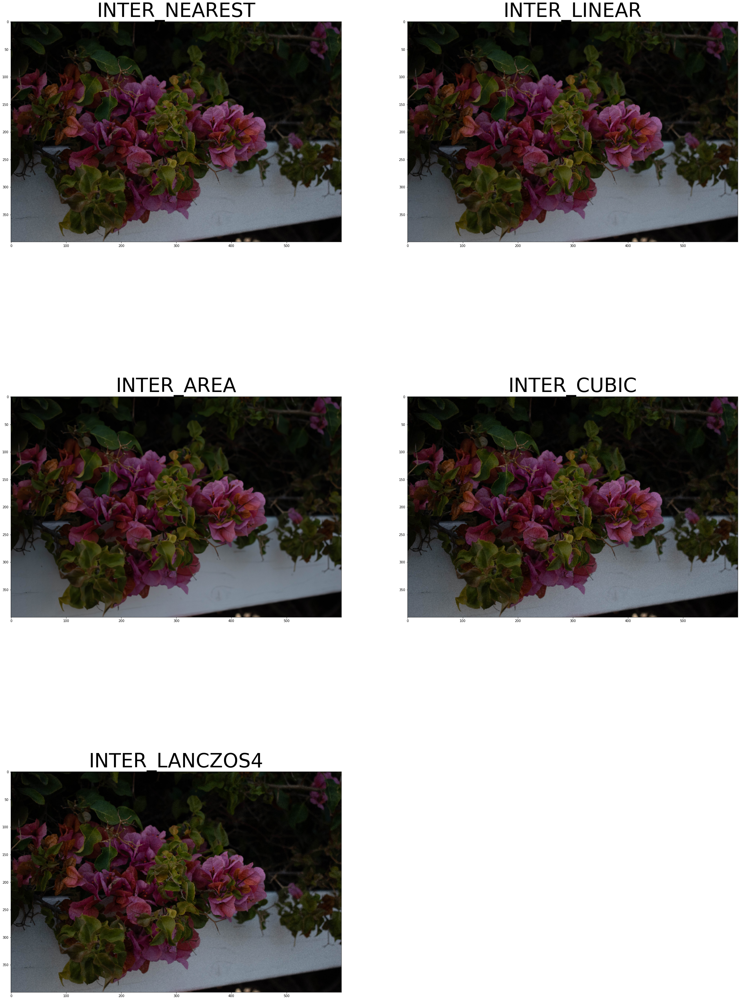

In [5]:
figure = plt.figure(figsize =(40,60))
ax1 = figure.add_subplot(3,2,1)
ax1.imshow(smaller_img(flower_arr, 1/10, cv2.INTER_NEAREST))
ax2 = figure.add_subplot(3,2,2)
ax2.imshow(smaller_img(flower_arr, 1/10, cv2.INTER_LINEAR))
ax3 = figure.add_subplot(3,2,3)
ax3.imshow(smaller_img(flower_arr, 1/10, cv2.INTER_AREA))
ax4 = figure.add_subplot(3,2,4)
ax4.imshow(smaller_img(flower_arr, 1/10, cv2.INTER_CUBIC ))
ax5 = figure.add_subplot(3,2,5)
ax5.imshow(smaller_img(flower_arr, 1/10, cv2.INTER_LANCZOS4 ))
ax1.title.set_text('INTER_NEAREST')
ax1.title.set_size(60)
ax2.title.set_text('INTER_LINEAR')
ax2.title.set_size(60)
ax3.title.set_text('INTER_AREA')
ax3.title.set_size(60)
ax4.title.set_text('INTER_CUBIC')
ax4.title.set_size(60)
ax5.title.set_text('INTER_LANCZOS4')
ax5.title.set_size(60);

I plotted the resulting images of compressing with different interpolation methods above. After comparison, I decided to use `cv2.INTER_AREA` since it outputs the smoothest image (with fewer noises compared to others). Since the original image is relatively large, I decided to make it 10 times smaller.

In [6]:
flower_img2 = smaller_img(flower_arr, 1/10, cv2.INTER_AREA)
flower_img2.shape

(400, 600, 3)

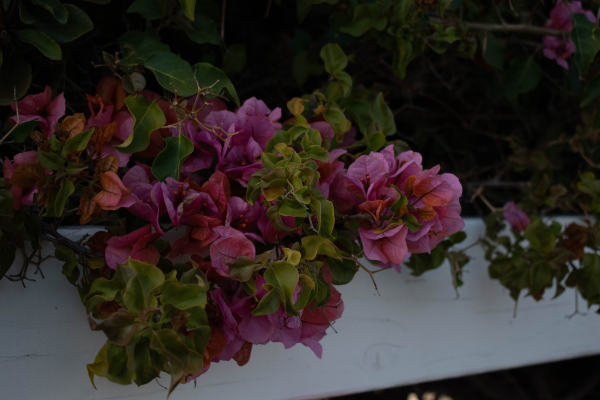

In [7]:
smaller_img = Image.fromarray(flower_img2)
display(smaller_img)

## Fix the image

Following is the `print_RGB_histogram()` method from DSC 96 lecture

In [8]:
def print_RGB_histogram(image_array):
    num_bins = 255

    fig, ax = plt.subplots(3, sharex=True)

    # the histogram of the data
    n, bins, patches = ax[0].hist(image_array[:,:,0].flatten(), num_bins, color="red")
    n, bins, patches = ax[1].hist(image_array[:,:,1].flatten(), num_bins, color="green")
    n, bins, patches = ax[2].hist(image_array[:,:,2].flatten(), num_bins, color="blue")

    plt.show()

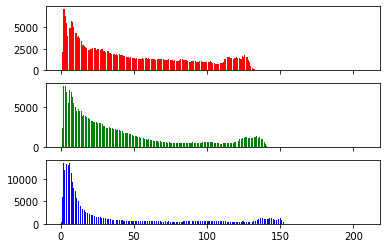

In [9]:
print_RGB_histogram(flower_img2)

We can observe that the RGB values have widespread, and most RGB values are relatively small. Thus, I would like to make the image lighter by multiplying all the values with a certain ratio. To calculate the ratio, I find the max value in the current image, and map the max value to 255.

In [10]:
flower_max = flower_img2.max()
flower_max

208

In [11]:
flower_ratio = 255/flower_max
flower_ratio

1.2259615384615385

In [12]:
flower_img3 = (flower_img2*flower_ratio).astype('uint8')
flower_img3.shape

(400, 600, 3)

Now, the image becomes brighter.

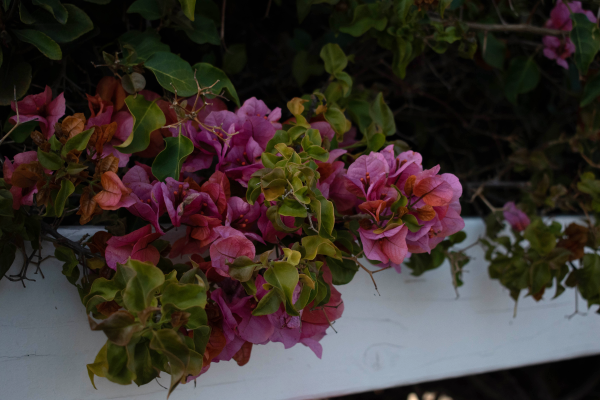

In [13]:
lighter_img = Image.fromarray(flower_img3)
display(lighter_img)

## How to have brigter flowers 💐 -- more changes to red channel

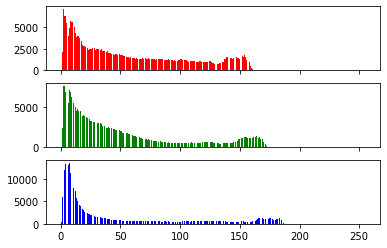

In [14]:
print_RGB_histogram(flower_img3)

However, from the RGB composition of the image, we can observe that the red channel still has relatively small values. This is probably because most high values are in the blue channel. <br>
<br>
Since flowers are the subject in my image, I would like them to be brighter than the other part of the image. To achieve this, I decided to further increase the brightness of the red channel since flowers are mostly composed of red colors.

In [15]:
flower_img4 = np.copy(flower_img3)

In [16]:
red_max_15 = pd.Series(flower_img4[:,:,0].flatten()).sort_values(ascending = False)
red_max_15 = red_max_15.take(np.arange(15)).reset_index()
red_max_15

,index,0
0,239813,255
1,239812,253
2,239814,247
3,239213,239
4,239212,237
5,239811,235
6,239815,231
7,239214,230
8,239211,223
9,238613,221


In [17]:
num_red_values = len(flower_img4[:,:,0].flatten())
num_red_values

240000

We can observe from the top 15 values in the red channel of the images that only the top 10 values out of 240000 values are greater than 220. Thus, I decided to map the 11th highest value in the red channel to 255.

In [18]:
higest_red_11 = red_max_15.iloc[10][0]
red_ratio = 255/higest_red_11 
red_ratio

1.1590909090909092

In [19]:
red_img_shape = flower_img4[:,:,0].shape
red_img_shape

(400, 600)

Write a list comprehension to increase red values. Map values greater or equal to 220 to 255.

In [20]:
new_red_lst = [int(v*red_ratio) if v < 220 else 255 for v in flower_img4[:,:,0].flatten()]
new_red_arr = np.array(new_red_lst).reshape(red_img_shape)
new_red_arr.shape

(400, 600)

In [21]:
flower_img4[:,:,0] = new_red_arr

The flowers become brighter :)

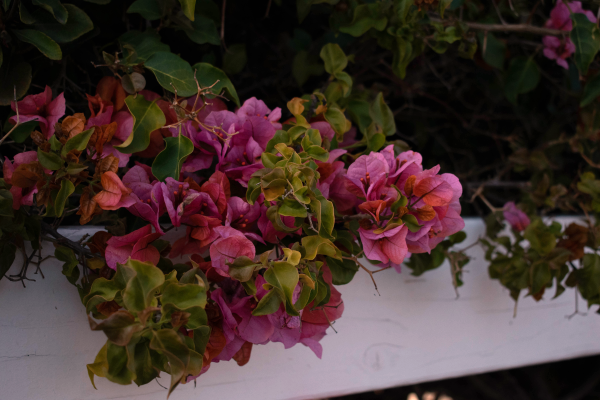

In [22]:
lighter_img = Image.fromarray(flower_img4)
display(lighter_img)

## Oil Painting effect 🎨

I would like to add an oil painting effect to make my image more artistic. Attached is a tutorial I found in [stackoverflow](https://stackoverflow.com/questions/60016168/how-to-implement-a-photoshop-like-effect-oilpaint-effect-in-opencv). 

In [23]:
img = flower_img4
# apply morphology open to smooth the outline
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (6,6))
morph = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)

# brighten dark regions
result = cv2.normalize(morph,None,20,255,cv2.NORM_MINMAX)

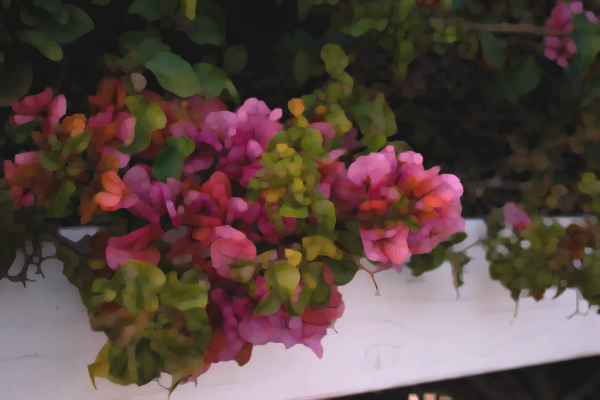

In [24]:
oil_painting_img = Image.fromarray(result)
display(oil_painting_img)

## Digital art effect 💻

We can create a digital art effect by changing the second parameter `(x,y)` in `cv2.getStructuringElement`. By using a small `x` and a large `y`, we can simulate an image generated with verticle strings.

In [25]:
img = flower_img4
# apply morphology open to smooth the outline
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (1,20))
morph = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)

# brighten dark regions
result = cv2.normalize(morph,None,20,255,cv2.NORM_MINMAX)

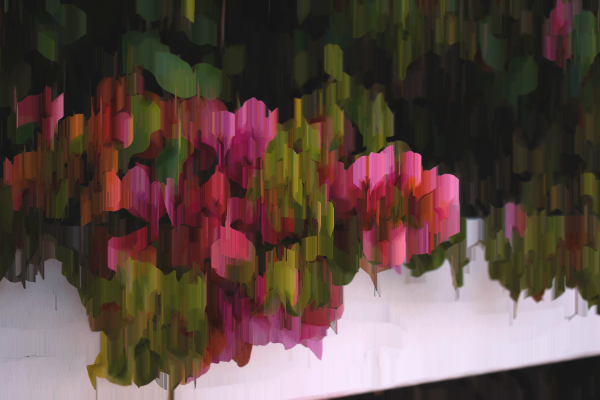

In [26]:
digital_art_img = Image.fromarray(result)
display(digital_art_img)

By using a large `x` and a slightly smaller `y`, we can simulate an image generated with horizontal lines and ellipses.

In [27]:
img = flower_img4
# apply morphology open to smooth the outline
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (20,10))
morph = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)

# brighten dark regions
result = cv2.normalize(morph,None,20,255,cv2.NORM_MINMAX)

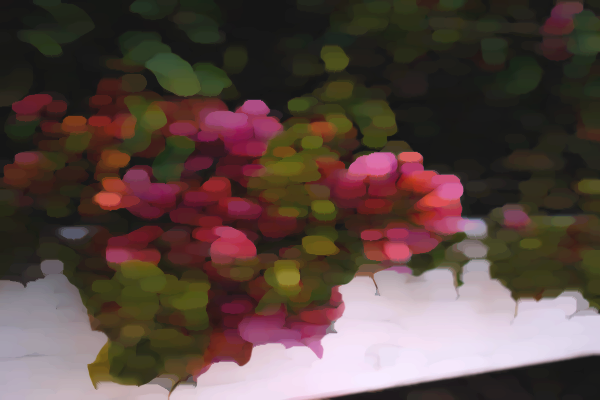

In [28]:
digital_art_img2 = Image.fromarray(result)
display(digital_art_img2)
# write result to disk
digital_art_img2.save('my_new_image.jpg')

Now, the image seems like a Monet-style painting (a little  similar to the lotus 🪷 in Monet's painting). Let's add a frame for the image. Attached is a [tutorial](https://codeigo.com/python/add-padding-to-images) on how to add padding to an image.

In [29]:
from PIL import Image

In [30]:
def padding_image(image, padding_values, padding_color):
    # Define the padding values.
    top, bottom, left, right = padding_values
    # Get the image shape: (width, height)
    width, height = image.size
    # Compute the size of the padded image. How each dimension will change.
    width2, height2 = width + left + right, height + top + bottom
    # Get the full image area after padding. This will be an image filled with the
    # padding color.
    padded_image = Image.new(mode="RGB", size=(width2, height2), color=padding_color)
    # paste the original image to the padding area defined above.
    # box - tuple giving the top left corner.
    padded_image.paste(image, box=(left, top))
    return padded_image

To make the frame more realistic, I found two common colors used for oil painting frames, and used them as padding colors for my image.

In [31]:
padding_values = (30, 30, 20, 20)
flower_img5 = padding_image(digital_art_img2, padding_values, (165, 120, 57))

In [32]:
padding_values = (10, 10, 10, 10)
flower_img5 = padding_image(flower_img5, padding_values, (226, 194, 115))

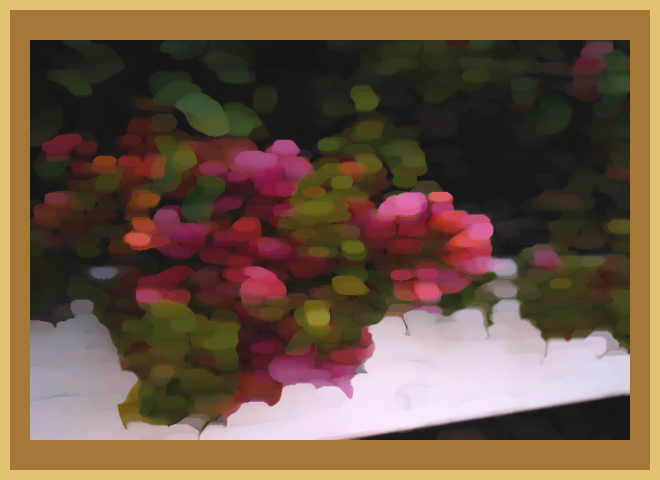

In [33]:
display(flower_img5)

I would also like to add a frame to my `oil_painting_img`. 

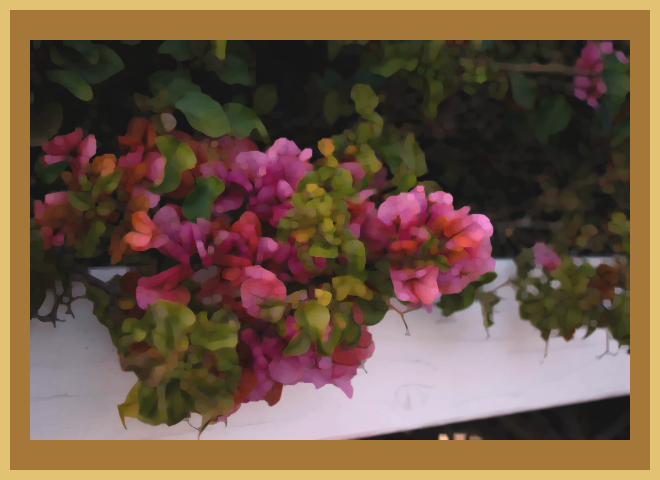

In [34]:
padding_values = (30, 30, 20, 20)
new_oil_painting_img = padding_image(oil_painting_img, padding_values, (165, 120, 57))
padding_values = (10, 10, 10, 10)
new_oil_painting_img = padding_image(new_oil_painting_img, padding_values, (226, 194, 115))
display(new_oil_painting_img)

<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>

# Conclusion
In the image project, I learned to compress the image with different methods and noticed that `cv2.INTER_AREA` works best for my flower image, though it may not be the best choice for other images.<br> <br>
After increasing the lightness of my photo, I found that my flowers are still not bright enough since they are mainly composed of red colors, but there are fewer high values in the red channel. Thus, to bring back more light to the flowers, I increased the light intensity of the red channel. To achieve this, I first looked into the red values distribution, and found that only 10 values out of all the values in the red channel have values larger than 220. Thus, I increased all values under 220 by multiplying a constant, and mapped all values greater or equal to 220 to 255.<br> <br>
I also learned to add filters to make various art effects on my image, and created frames for my images by understanding and using the padding method creatively.